Импортируем необходимые библиотеки

In [1]:
import nltk
import pickle
import argparse
import os
import json
from collections import Counter
from pycocotools.coco import COCO

import torch
import torch.nn as nn
import numpy as np
import pickle
import matplotlib.pyplot as plt
from matplotlib import gridspec
from torch.nn.utils.rnn import pack_padded_sequence
from torchvision import transforms
from PIL import Image
from torch.utils.tensorboard import SummaryWriter
import requests
import torchvision
import torchvision.transforms as transforms
import torch.utils.data as data

import torchvision.models as models
import nltk
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

Объявляем класс словаря для дальнейшего построения описания картинок на его основе

In [2]:
class Vocabulary(object):
    """Simple vocabulary wrapper."""
    def __init__(self):
        self.word2idx = {}
        self.idx2word = {}
        self.idx = 0

    def add_word(self, word):
        if not word in self.word2idx:
            self.word2idx[word] = self.idx
            self.idx2word[self.idx] = word
            self.idx += 1

    def __call__(self, word):
        if not word in self.word2idx:
            return self.word2idx['<unk>']
        return self.word2idx[word]

    def __len__(self):
        return len(self.word2idx)


In [3]:
def build_vocab(json, threshold):
    """Build a simple vocabulary wrapper."""
    coco = COCO(json)
    counter = Counter()
    ids = coco.anns.keys()
    for i, id in enumerate(ids):
        caption = str(coco.anns[id]['caption'])
        tokens = nltk.tokenize.word_tokenize(caption.lower())
        counter.update(tokens)

        if (i+1) % 1000 == 0:
            print("[{}/{}] Tokenized the captions.".format(i+1, len(ids)))

    # If the word frequency is less than 'threshold', then the word is discarded.
    words = [word for word, cnt in counter.items() if cnt >= threshold]

    # Create a vocab wrapper and add some special tokens.
    vocab = Vocabulary()
    vocab.add_word('<pad>')
    vocab.add_word('<start>')
    vocab.add_word('<end>')
    vocab.add_word('<unk>')

    # Add the words to the vocabulary.
    for i, word in enumerate(words):
        vocab.add_word(word)
    return vocab


Будем использовать датасет COCO 2014 года. Я не нашел хорошего способа скачать его частично, поэтому качаем полностью, но юзаем частично.

In [4]:
!wget -c http://images.cocodataset.org/annotations/annotations_trainval2014.zip
!unzip -o annotations_trainval2014.zip
!rm annotations_trainval2014.zip

!wget -c http://images.cocodataset.org/zips/train2014.zip
!unzip -o train2014.zip
!rm train2014.zip

!wget -c http://images.cocodataset.org/zips/val2014.zip
!unzip -o val2014.zip
!rm val2014.zip

Выходные данные были обрезаны до нескольких последних строк (5000).
 extracting: val2014/COCO_val2014_000000535608.jpg  
 extracting: val2014/COCO_val2014_000000279145.jpg  
 extracting: val2014/COCO_val2014_000000243495.jpg  
 extracting: val2014/COCO_val2014_000000225791.jpg  
 extracting: val2014/COCO_val2014_000000428067.jpg  
 extracting: val2014/COCO_val2014_000000059383.jpg  
 extracting: val2014/COCO_val2014_000000558498.jpg  
 extracting: val2014/COCO_val2014_000000376123.jpg  
 extracting: val2014/COCO_val2014_000000191304.jpg  
 extracting: val2014/COCO_val2014_000000171062.jpg  
 extracting: val2014/COCO_val2014_000000014549.jpg  
 extracting: val2014/COCO_val2014_000000121152.jpg  
 extracting: val2014/COCO_val2014_000000276596.jpg  
 extracting: val2014/COCO_val2014_000000029431.jpg  
 extracting: val2014/COCO_val2014_000000036349.jpg  
 extracting: val2014/COCO_val2014_000000502055.jpg  
 extracting: val2014/COCO_val2014_000000438848.jpg  
 extracting: val2014/COCO_val20

Строим словари для наборов train и val

In [5]:
caption_path='/content/annotations/captions_train2014.json'
vocab_path = '/content/vocab.pkl'
threshold=4

vocab = build_vocab(json=caption_path, threshold=threshold)
vocab_path = vocab_path
with open(vocab_path, 'wb') as f:
    pickle.dump(vocab, f)
print("Total vocabulary size: {}".format(len(vocab)))
print("Saved the vocabulary wrapper to '{}'".format(vocab_path))

loading annotations into memory...
Done (t=0.87s)
creating index...
index created!
[1000/414113] Tokenized the captions.
[2000/414113] Tokenized the captions.
[3000/414113] Tokenized the captions.
[4000/414113] Tokenized the captions.
[5000/414113] Tokenized the captions.
[6000/414113] Tokenized the captions.
[7000/414113] Tokenized the captions.
[8000/414113] Tokenized the captions.
[9000/414113] Tokenized the captions.
[10000/414113] Tokenized the captions.
[11000/414113] Tokenized the captions.
[12000/414113] Tokenized the captions.
[13000/414113] Tokenized the captions.
[14000/414113] Tokenized the captions.
[15000/414113] Tokenized the captions.
[16000/414113] Tokenized the captions.
[17000/414113] Tokenized the captions.
[18000/414113] Tokenized the captions.
[19000/414113] Tokenized the captions.
[20000/414113] Tokenized the captions.
[21000/414113] Tokenized the captions.
[22000/414113] Tokenized the captions.
[23000/414113] Tokenized the captions.
[24000/414113] Tokenized the 

In [6]:
caption_path='/content/annotations/captions_val2014.json'
vocab_path = '/content/vocab_val.pkl'
threshold=4

vocab = build_vocab(json=caption_path, threshold=threshold)
vocab_path = vocab_path
with open(vocab_path, 'wb') as f:
    pickle.dump(vocab, f)
print("Total vocabulary size: {}".format(len(vocab)))
print("Saved the vocabulary wrapper to '{}'".format(vocab_path))

loading annotations into memory...
Done (t=0.43s)
creating index...
index created!
[1000/202654] Tokenized the captions.
[2000/202654] Tokenized the captions.
[3000/202654] Tokenized the captions.
[4000/202654] Tokenized the captions.
[5000/202654] Tokenized the captions.
[6000/202654] Tokenized the captions.
[7000/202654] Tokenized the captions.
[8000/202654] Tokenized the captions.
[9000/202654] Tokenized the captions.
[10000/202654] Tokenized the captions.
[11000/202654] Tokenized the captions.
[12000/202654] Tokenized the captions.
[13000/202654] Tokenized the captions.
[14000/202654] Tokenized the captions.
[15000/202654] Tokenized the captions.
[16000/202654] Tokenized the captions.
[17000/202654] Tokenized the captions.
[18000/202654] Tokenized the captions.
[19000/202654] Tokenized the captions.
[20000/202654] Tokenized the captions.
[21000/202654] Tokenized the captions.
[22000/202654] Tokenized the captions.
[23000/202654] Tokenized the captions.
[24000/202654] Tokenized the 

"Нормализуем" картинки из обоих наборов, приводя их к одному и тому же размеру

In [7]:
def resize_image(image, size):
    """Resize an image to the given size."""
    return image.resize(size, Image.ANTIALIAS)

def resize_images(image_dir, output_dir, size):
    """Resize the images in 'image_dir' and save into 'output_dir'."""
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    images = os.listdir(image_dir)
    num_images = len(images)
    for i, image in enumerate(images):
        with open(os.path.join(image_dir, image), 'r+b') as f:
            with Image.open(f) as img:
                img = resize_image(img, size)
                img.save(os.path.join(output_dir, image), img.format)
        if (i+1) % 100 == 0:
            print ("[{}/{}] Resized the images and saved into '{}'."
                   .format(i+1, num_images, output_dir))

In [8]:
image_dir = '/content/val2014'
output_dir = '/content/val2014_resized'
image_size = [256, 256]
resize_images(image_dir, output_dir, image_size)

[100/40504] Resized the images and saved into '/content/val2014_resized'.
[200/40504] Resized the images and saved into '/content/val2014_resized'.
[300/40504] Resized the images and saved into '/content/val2014_resized'.
[400/40504] Resized the images and saved into '/content/val2014_resized'.
[500/40504] Resized the images and saved into '/content/val2014_resized'.
[600/40504] Resized the images and saved into '/content/val2014_resized'.
[700/40504] Resized the images and saved into '/content/val2014_resized'.
[800/40504] Resized the images and saved into '/content/val2014_resized'.
[900/40504] Resized the images and saved into '/content/val2014_resized'.
[1000/40504] Resized the images and saved into '/content/val2014_resized'.
[1100/40504] Resized the images and saved into '/content/val2014_resized'.
[1200/40504] Resized the images and saved into '/content/val2014_resized'.
[1300/40504] Resized the images and saved into '/content/val2014_resized'.
[1400/40504] Resized the images an

In [9]:
image_dir = '/content/train2014'
output_dir = '/content/train2014_resized'
image_size = [256, 256]
resize_images(image_dir, output_dir, image_size)

[100/82783] Resized the images and saved into '/content/train2014_resized'.
[200/82783] Resized the images and saved into '/content/train2014_resized'.
[300/82783] Resized the images and saved into '/content/train2014_resized'.
[400/82783] Resized the images and saved into '/content/train2014_resized'.
[500/82783] Resized the images and saved into '/content/train2014_resized'.
[600/82783] Resized the images and saved into '/content/train2014_resized'.
[700/82783] Resized the images and saved into '/content/train2014_resized'.
[800/82783] Resized the images and saved into '/content/train2014_resized'.
[900/82783] Resized the images and saved into '/content/train2014_resized'.
[1000/82783] Resized the images and saved into '/content/train2014_resized'.
[1100/82783] Resized the images and saved into '/content/train2014_resized'.
[1200/82783] Resized the images and saved into '/content/train2014_resized'.
[1300/82783] Resized the images and saved into '/content/train2014_resized'.
[1400/82

Используем в качестве encoder предобученную модель resnet-152 без последнего слоя, в качестве decoder обучим модель LSTM

In [10]:
class EncoderCNN(nn.Module):
    def __init__(self, embed_size):
        """Load the pretrained ResNet-152 and replace top fc layer."""
        super(EncoderCNN, self).__init__()
        resnet = models.resnet152(pretrained=True)
        modules = list(resnet.children())[:-1]      # delete the last fc layer.
        self.resnet = nn.Sequential(*modules)
        self.linear = nn.Linear(resnet.fc.in_features, embed_size)
        self.bn = nn.BatchNorm1d(embed_size, momentum=0.01)
        
    def forward(self, images):
        """Extract feature vectors from input images."""
        with torch.no_grad():
            features = self.resnet(images)
        features = features.reshape(features.size(0), -1)
        features = self.bn(self.linear(features))
        return features


class DecoderRNN(nn.Module):
    def __init__(self, embed_size, hidden_size, vocab_size, num_layers, max_seq_length=20):
        """Set the hyper-parameters and build the layers."""
        super(DecoderRNN, self).__init__()
        self.embed = nn.Embedding(vocab_size, embed_size)
        self.lstm = nn.LSTM(embed_size, hidden_size, num_layers, batch_first=True)
        self.linear = nn.Linear(hidden_size, vocab_size)
        self.max_seg_length = max_seq_length
        
    def forward(self, features, captions, lengths):
        """Decode image feature vectors and generates captions."""
        embeddings = self.embed(captions)
        embeddings = torch.cat((features.unsqueeze(1), embeddings), 1)
        packed = pack_padded_sequence(embeddings, lengths, batch_first=True) 
        hiddens, _ = self.lstm(packed)
        outputs = self.linear(hiddens[0])
        return outputs
    
    def sample(self, features, states=None):
        """Generate captions for given image features using greedy search."""
        sampled_ids = []
        inputs = features.unsqueeze(1)
        for i in range(self.max_seg_length):
            hiddens, states = self.lstm(inputs, states)          # hiddens: (batch_size, 1, hidden_size)
            outputs = self.linear(hiddens.squeeze(1))            # outputs:  (batch_size, vocab_size)
            _, predicted = outputs.max(1)                        # predicted: (batch_size)
            sampled_ids.append(predicted)
            inputs = self.embed(predicted)                       # inputs: (batch_size, embed_size)
            inputs = inputs.unsqueeze(1)                         # inputs: (batch_size, 1, embed_size)
        sampled_ids = torch.stack(sampled_ids, 1)                # sampled_ids: (batch_size, max_seq_length)
        return sampled_ids

In [11]:
# Device configuration
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

Для удобства работы с датасетом COCO используем враппер, который будет юзать файл с аннотацией, папку с картинками и заранее сгенерированный словарь

In [12]:
class CocoDataset(data.Dataset):
    """COCO Custom Dataset compatible with torch.utils.data.DataLoader."""
    def __init__(self, root, json, vocab, transform=None):
        """Set the path for images, captions and vocabulary wrapper.
        
        Args:
            root: image directory.
            json: coco annotation file path.
            vocab: vocabulary wrapper.
            transform: image transformer.
        """
        self.root = root
        self.coco = COCO(json)
        self.ids = list(self.coco.anns.keys())
        self.vocab = vocab
        self.transform = transform

    def __getitem__(self, index):
        """Returns one data pair (image and caption)."""
        coco = self.coco
        vocab = self.vocab
        ann_id = self.ids[index]
        caption = coco.anns[ann_id]['caption']
        img_id = coco.anns[ann_id]['image_id']
        path = coco.loadImgs(img_id)[0]['file_name']
        
        image = Image.open(os.path.join(self.root, path)).convert('RGB')
        if self.transform is not None:
            image = self.transform(image)

        # Convert caption (string) to word ids.
        tokens = nltk.tokenize.word_tokenize(str(caption).lower())
        caption = []
        caption.append(vocab('<start>'))
        caption.extend([vocab(token) for token in tokens])
        caption.append(vocab('<end>'))
        target = torch.Tensor(caption)
        return image, target

    def __len__(self):
        return len(self.ids)


def collate_fn(data):
    """Creates mini-batch tensors from the list of tuples (image, caption).
    
    We should build custom collate_fn rather than using default collate_fn, 
    because merging caption (including padding) is not supported in default.
    Args:
        data: list of tuple (image, caption). 
            - image: torch tensor of shape (3, 256, 256).
            - caption: torch tensor of shape (?); variable length.
    Returns:
        images: torch tensor of shape (batch_size, 3, 256, 256).
        targets: torch tensor of shape (batch_size, padded_length).
        lengths: list; valid length for each padded caption.
    """
    # Sort a data list by caption length (descending order).
    data.sort(key=lambda x: len(x[1]), reverse=True)
    images, captions = zip(*data)

    # Merge images (from tuple of 3D tensor to 4D tensor).
    images = torch.stack(images, 0)

    # Merge captions (from tuple of 1D tensor to 2D tensor).
    lengths = [len(cap) for cap in captions]
    targets = torch.zeros(len(captions), max(lengths)).long()
    for i, cap in enumerate(captions):
        end = lengths[i]
        targets[i, :end] = cap[:end]        
    return images, targets, lengths

def get_loader(root, json, vocab, transform, batch_size, shuffle, num_workers):
    """Returns torch.utils.data.DataLoader for custom coco dataset."""
    # COCO caption dataset
    coco = CocoDataset(root=root,
                       json=json,
                       vocab=vocab,
                       transform=transform)
    
    # Data loader for COCO dataset
    # This will return (images, captions, lengths) for each iteration.
    # images: a tensor of shape (batch_size, 3, 224, 224).
    # captions: a tensor of shape (batch_size, padded_length).
    # lengths: a list indicating valid length for each caption. length is (batch_size).
    data_loader = torch.utils.data.DataLoader(dataset=coco, 
                                              batch_size=batch_size,
                                              shuffle=shuffle,
                                              num_workers=num_workers,
                                              collate_fn=collate_fn)
    return data_loader

В коллбэке будем строить качества обучения (ошибка на train от итерации), теста (ошибка на val от итерации), а так же возьмем картинку из набора val и пронаблюдаем эволюция сгенерированных к ней описаний

In [13]:
class callback():
    def __init__(self, writer, loss_function, delimeter = 100, batch_size=64):
        self.step = 0
        self.writer = writer
        self.delimeter = delimeter
        self.loss_function = loss_function
        self.batch_size = batch_size
    def load_image(self, image_path, transform=None):
        image = Image.open(image_path).convert('RGB')
        image = image.resize([224, 224], Image.LANCZOS)
        
        if transform is not None:
            image = transform(image).unsqueeze(0)
        
        return image

    def forward(self, encoder, decoder, loss):
        self.step += 1
        self.writer.add_scalar('LOSS/train', loss, self.step)
        
        image_path = '/content/val2014/COCO_val2014_000000001029.jpg' # can by any image from val2014
        val_root = '/content/val2014_resized'
        val_json = '/content/annotations/captions_val2014.json'
        val_vocab_path = '/content/vocab_val.pkl'
        with open(val_vocab_path, 'rb') as f:
          val_vocab = pickle.load(f)
        transform = transforms.Compose([ 
          transforms.RandomCrop(crop_size),
          transforms.RandomHorizontalFlip(), 
          transforms.ToTensor(), 
          transforms.Normalize((0.485, 0.456, 0.406), 
                                (0.229, 0.224, 0.225))])
        num_workers = 2

        if self.step % self.delimeter == 0:
            batch_generator = get_loader(val_root, val_json, val_vocab, transform, self.batch_size, True, num_workers)

            # generate graphs
            test_loss = 0
            end = 25
            for i, (images, captions, lengths) in enumerate(batch_generator):
              # Set mini-batch dataset
              images = images.to(device)
              captions = captions.to(device)
              targets = pack_padded_sequence(captions, lengths, batch_first=True)[0]
              
              # Forward, backward and optimize
              features = encoder(images)
              outputs = decoder(features, captions, lengths)
              test_loss += self.loss_function(outputs, targets).cpu().item()*len(images)
              if i == end:
                break
            
            test_loss /= (end * batch_size)
            self.writer.add_scalar('LOSS/test', test_loss, self.step)

            # generate image with description
            transform = transforms.Compose([
              transforms.ToTensor(), 
              transforms.Normalize((0.485, 0.456, 0.406), 
                                  (0.229, 0.224, 0.225))])

            # Prepare an image
            image = self.load_image(image_path, transform)
            image_tensor = image.to(device)
            
            # Generate an caption from the image
            feature = encoder.eval()(image_tensor)
            sampled_ids = decoder.sample(feature)
            sampled_ids = sampled_ids[0].cpu().numpy()          # (1, max_seq_length) -> (max_seq_length)
            
            # Convert word_ids to words
            sampled_caption = []
            for word_id in sampled_ids:
                word = vocab.idx2word[word_id]
                sampled_caption.append(word)
                if word == '<end>':
                    break
            sentence = ' '.join(sampled_caption)

            fig = plt.figure(figsize=(45, 20))
            plt.title(sentence, fontsize=16)
            plt.xticks([])
            plt.yticks([])
            plt.grid(False)
            plt.imshow(np.asarray(Image.open(image_path).convert('RGB')), cmap=plt.cm.binary)

            self.writer.add_figure('COCO/descs', fig, self.step)
          
    def __call__(self, encoder, decoder, loss):
        return self.forward(encoder, decoder, loss)

Посмотрим, что показывает необученная модель

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet152_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet152_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet152-394f9c45.pth" to /root/.cache/torch/hub/checkpoints/resnet152-394f9c45.pth
100%|██████████| 230M/230M [00:00<00:00, 246MB/s]


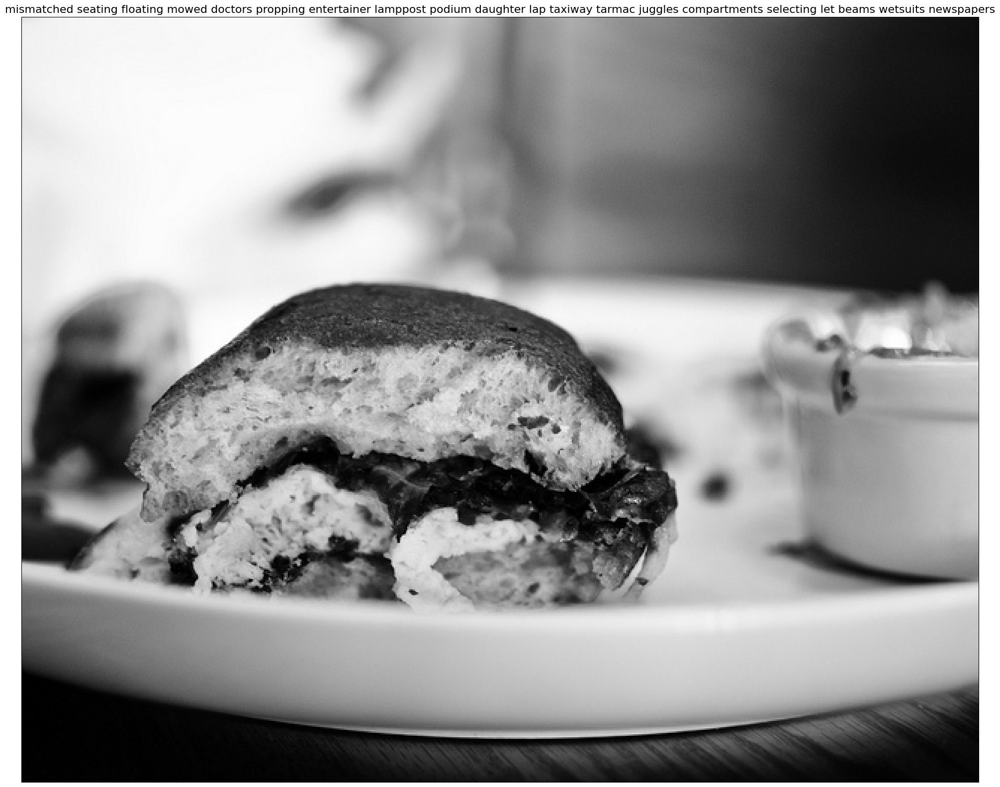

In [14]:
embed_size = 256
hidden_size = 512
num_layers = 1
vocab_path = '/content/vocab.pkl'

with open(vocab_path, 'rb') as f:
    vocab = pickle.load(f)

def load_image(image_path, transform=None):
        image = Image.open(image_path).convert('RGB')
        image = image.resize([224, 224], Image.LANCZOS)
        
        if transform is not None:
            image = transform(image).unsqueeze(0)
        
        return image

encoder = EncoderCNN(embed_size).to(device)
decoder = DecoderRNN(embed_size, hidden_size, len(vocab), num_layers).to(device)

# generate image with description
transform = transforms.Compose([
transforms.ToTensor(), 
transforms.Normalize((0.485, 0.456, 0.406), 
                    (0.229, 0.224, 0.225))])

image_path = '/content/val2014/COCO_val2014_000000001425.jpg'

# Prepare an image
image = load_image(image_path, transform)
image_tensor = image.to(device)

# Generate an caption from the image
feature = encoder.eval()(image_tensor)
sampled_ids = decoder.sample(feature)
sampled_ids = sampled_ids[0].cpu().numpy()          # (1, max_seq_length) -> (max_seq_length)

# Convert word_ids to words
sampled_caption = []
for word_id in sampled_ids:
  word = vocab.idx2word[word_id]
  sampled_caption.append(word)
  if word == '<end>':
      break
sentence = ' '.join(sampled_caption)

fig = plt.figure(figsize=(45, 20))
plt.title(sentence, fontsize=16)
plt.xticks([])
plt.yticks([])
plt.grid(False)
plt.imshow(np.asarray(Image.open(image_path).convert('RGB')), cmap=plt.cm.binary)

Проведем обучение модели на части сэмплов из датасета COCO 2014 (train)

In [15]:
model_path='/content/models'
crop_size = 224
vocab_path = '/content/vocab.pkl'
image_dir = '/content/train2014_resized'
caption_path='/content/annotations/captions_train2014.json'
log_step = 10
save_step = 1000
end_step = 350 # trim all data
embed_size = 256
hidden_size = 512
num_layers = 1
num_epochs = 1
batch_size = 128
num_workers = 2
learning_rate = 0.001

# Create model directory
if not os.path.exists(model_path):
    os.makedirs(model_path)

# Image preprocessing, normalization for the pretrained resnet
transform = transforms.Compose([ 
    transforms.RandomCrop(crop_size),
    transforms.RandomHorizontalFlip(), 
    transforms.ToTensor(), 
    transforms.Normalize((0.485, 0.456, 0.406), 
                          (0.229, 0.224, 0.225))])

# Load vocabulary wrapper
with open(vocab_path, 'rb') as f:
    vocab = pickle.load(f)

# Build data loader
data_loader = get_loader(image_dir, caption_path, vocab, 
                          transform, batch_size,
                          shuffle=True, num_workers=num_workers) 

# Build the models
encoder = EncoderCNN(embed_size).to(device)
decoder = DecoderRNN(embed_size, hidden_size, len(vocab), num_layers).to(device)

# Loss and optimizer
criterion = nn.CrossEntropyLoss()
params = list(decoder.parameters()) + list(encoder.linear.parameters()) + list(encoder.bn.parameters())
optimizer = torch.optim.Adam(params, lr=learning_rate)

writer = SummaryWriter(log_dir = 'tensorflow')
call = callback(writer, criterion, delimeter = 10)

# Train the models
total_step = len(data_loader)
for epoch in range(num_epochs):
    for i, (images, captions, lengths) in enumerate(data_loader):
        # Set mini-batch dataset
        images = images.to(device)
        captions = captions.to(device)
        targets = pack_padded_sequence(captions, lengths, batch_first=True)[0]
        
        # Forward, backward and optimize
        features = encoder(images)
        outputs = decoder(features, captions, lengths)
        loss = criterion(outputs, targets)
        decoder.zero_grad()
        encoder.zero_grad()
        loss.backward()
        optimizer.step()

        call(encoder, decoder, loss)

        # Print log info
        if i % log_step == 0:
            print('Epoch [{}/{}], Step [{}/{}], Loss: {:.4f}, Perplexity: {:5.4f}'
                  .format(epoch, num_epochs, i, total_step, loss.item(), np.exp(loss.item()))) 
            
        # Save the model checkpoints
        if (i+1) % save_step == 0:
            torch.save(decoder.state_dict(), os.path.join(
                model_path, 'decoder-{}-{}.ckpt'.format(epoch+1, i+1)))
            torch.save(encoder.state_dict(), os.path.join(
                model_path, 'encoder-{}-{}.ckpt'.format(epoch+1, i+1)))

        if (i+1) % end_step == 0:
          break

loading annotations into memory...
Done (t=0.87s)
creating index...
index created!
Epoch [0/1], Step [0/3236], Loss: 9.2077, Perplexity: 9973.9618
loading annotations into memory...
Done (t=0.74s)
creating index...
index created!
Epoch [0/1], Step [10/3236], Loss: 5.8076, Perplexity: 332.8053
loading annotations into memory...
Done (t=0.28s)
creating index...
index created!
Epoch [0/1], Step [20/3236], Loss: 4.8768, Perplexity: 131.2078
loading annotations into memory...
Done (t=0.29s)
creating index...
index created!
Epoch [0/1], Step [30/3236], Loss: 4.5656, Perplexity: 96.1250
loading annotations into memory...
Done (t=0.27s)
creating index...
index created!
Epoch [0/1], Step [40/3236], Loss: 4.3787, Perplexity: 79.7311
loading annotations into memory...
Done (t=0.29s)
creating index...
index created!
Epoch [0/1], Step [50/3236], Loss: 4.2990, Perplexity: 73.6239
loading annotations into memory...
Done (t=0.56s)
creating index...
index created!
Epoch [0/1], Step [60/3236], Loss: 4.0

Проверим работу модели после обучения

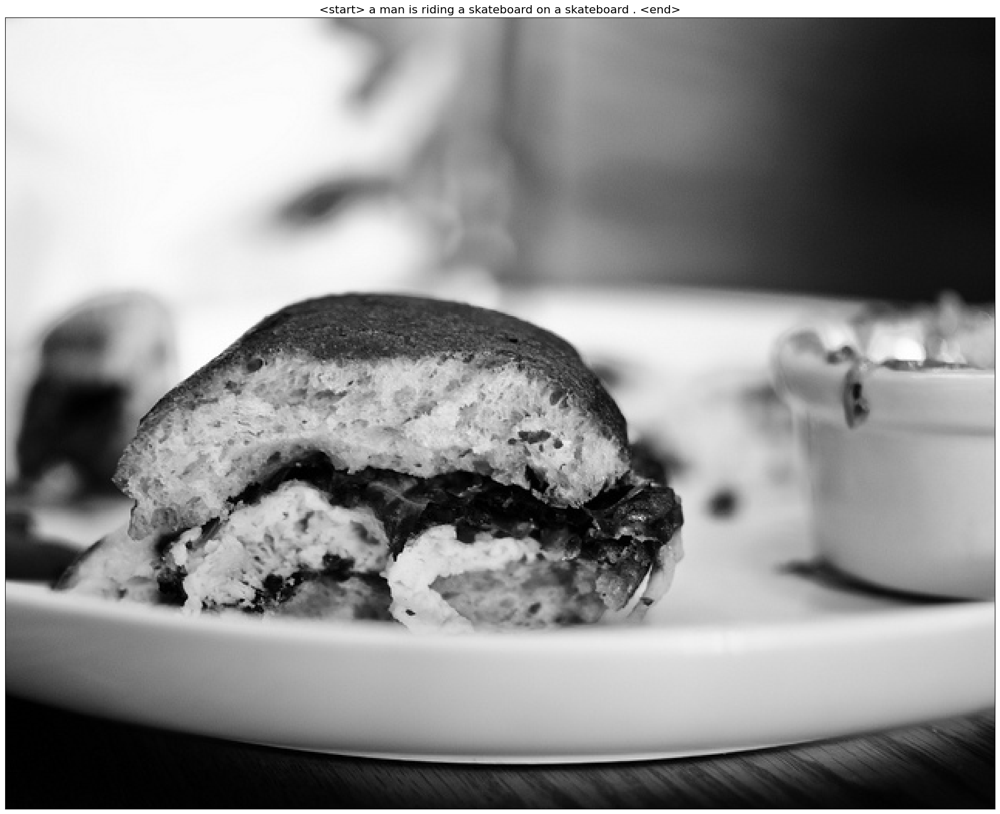

In [16]:
def load_image(image_path, transform=None):
  image = Image.open(image_path).convert('RGB')
  image = image.resize([224, 224], Image.LANCZOS)

  if transform is not None:
      image = transform(image).unsqueeze(0)

  return image

# generate image with description
transform = transforms.Compose([
transforms.ToTensor(), 
transforms.Normalize((0.485, 0.456, 0.406), 
                    (0.229, 0.224, 0.225))])

image_path = '/content/val2014/COCO_val2014_000000001425.jpg'

# Prepare an image
image = load_image(image_path, transform)
image_tensor = image.to(device)

# Generate an caption from the image
feature = encoder.eval()(image_tensor)
sampled_ids = decoder.sample(feature)
sampled_ids = sampled_ids[0].cpu().numpy()          # (1, max_seq_length) -> (max_seq_length)

# Convert word_ids to words
sampled_caption = []
for word_id in sampled_ids:
  word = vocab.idx2word[word_id]
  sampled_caption.append(word)
  if word == '<end>':
      break
sentence = ' '.join(sampled_caption)

fig = plt.figure(figsize=(45, 20))
plt.title(sentence, fontsize=16)
plt.xticks([])
plt.yticks([])
plt.grid(False)
plt.imshow(np.asarray(Image.open(image_path).convert('RGB')), cmap=plt.cm.binary)

Модель успешно обучилась, и показала себя вполне неплохо. Из-за того, что мы обучаемся лишь на малой части данных, мы попали на переообучение и обучились не так хорошо, как хотелось бы. Но прогресс виден.

In [19]:
%load_ext tensorboard
%tensorboard --logdir . --port=7080

Output hidden; open in https://colab.research.google.com to view.

In [20]:
!zip -r /content/all_tensorboards.zip /content/tensorflow

  adding: content/tensorflow/ (stored 0%)
  adding: content/tensorflow/events.out.tfevents.1680566154.6e0266ffd512.365.0 (deflated 5%)
